# Домашнее задание №2

Задание присылать на обе почты почты aleksartamonov@gmail.com dashkov.alexander.om@gmail.com в виде ссылки на colab

В теме письма указать **CV_HSE_2021 HW2 <Фамилия Имя>**

soft deadline: 14.03.2021T23:59:00+0300

hard deadline: 21.03.2021T23:59:00+0300

In [1]:
from functools import update_wrapper
from os import listdir
from os.path import join
from typing import Tuple, List, Callable, Any

import ipywidgets as widgets
import cv2
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from tqdm.notebook import tqdm

%matplotlib inline
plt.style.use('default')

In [2]:
def mean_squared_error(img1: np.ndarray, img2: np.ndarray) -> float:
    return np.mean((img1.astype(float) - img2.astype(float)) ** 2)

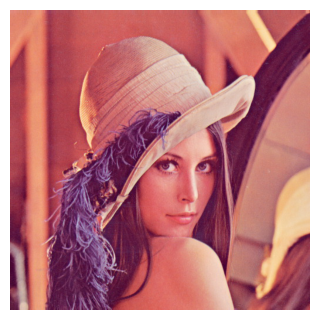

In [3]:
def show(img, size=3):
    plt.figure(figsize=(size, size))
    ax = plt.axes([0,0,1,1], frameon=False)
    ax.set_axis_off()
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

def gray_show(img, size=3):
    plt.figure(figsize=(size, size))
    ax = plt.axes([0,0,1,1], frameon=False)
    ax.set_axis_off()
    plt.imshow(img, cmap='gray')
    
lena = cv2.imread("lena.jpg")
show(lena)

**1. (6 баллов)** С помощью [виджетов](http://ipywidgets.readthedocs.io/en/latest/examples/Widget%20List.html) создайте 2 слайдера с настройками параметров гамма-коррекции. Отобразите **lena**, ее гамма-преобразование и график в диапозоне от [0;1], так, чтобы параметры слайдера соответствовали параметрам гамма-коррекции. 

In [4]:
def gamma_correction(image: np.ndarray, c: float, gamma: float) -> np.ndarray:
    image = image.astype(float)
    eq = c * np.power(image / 255, gamma) * 255
    return eq.astype(np.uint8)

In [5]:
widget_c = widgets.FloatSlider(
    value=1.0, min=0.0, max=1.0, step=0.05, description='C:',
    disabled=False, continuous_update=True, orientation='horizontal',
    readout=True, readout_format='.2f',
)
widget_gamma = widgets.FloatSlider(
    value=1, min=0, max=2.0, step=0.05, description='gamma:',
    disabled=False, continuous_update=True, orientation='horizontal',
    readout=True, readout_format='.2f',
)

@widgets.interact(c=widget_c, gamma=widget_gamma)
def show_gamma_normalization(c, gamma):
    new_image = gamma_correction(lena, c, gamma)
    xs = np.linspace(0.0, 1.0, 100)
    ys = c * np.power(xs, gamma)

    fig, axis = plt.subplots(2, 1)
    axis[0].set_axis_off()
    axis[0].imshow(cv2.cvtColor(new_image, cv2.COLOR_BGR2RGB))
    axis[1].plot(xs, ys,)

    plt.show()

interactive(children=(FloatSlider(value=1.0, description='C:', max=1.0, step=0.05), FloatSlider(value=1.0, des…

**2. (5 баллов)** Загрузите изображение $lena.jpg$. Переведите изображение в градации серого. Примените к серому изображению операцию линейного растяжения диапазона яркостей ($normalize$) и эквализации гистограммы ($equalizeHist$). Постройте разность полученных результатов. Состыкуйте в одно изображение в градациях серого результат линейного растяжения, эквализации и их разности.

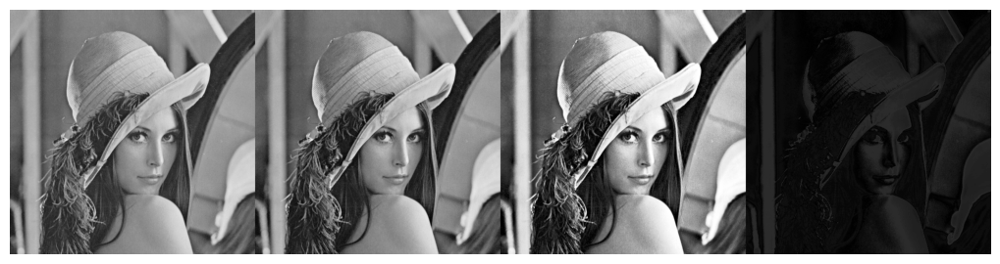

In [6]:
lena_gray = cv2.cvtColor(lena, cv2.COLOR_BGR2GRAY)
lena_normalized = cv2.normalize(lena_gray, None, 0, 255, cv2.NORM_MINMAX)
lena_equiv = cv2.equalizeHist(lena_gray)
diff = cv2.absdiff(lena_normalized, lena_equiv)

h, w = lena_gray.shape
full_image = np.zeros((h, 4 * w))
full_image[:, :w] = lena_gray
full_image[:, w: 2 * w] = lena_normalized
full_image[:, 2 * w: 3 * w] = lena_equiv
full_image[:, 3 * w:] = diff

gray_show(full_image, size=10)

**3. (5 баллов)** Реализуйте функцию добавления шума «соль и перец» для одноканального изображения. Входные параметры: $src$ – исходная одноканальная матрица $Mat$, $p$ – вероятность замещения исходных значений на $0$, $q$ – вероятность замещения исходных значений на $255$. Загрузите изображение $lena.jpg$, выделите каналы изображения в отдельные матрицы ($split$), добавьте шум «соль и перец» в каждый канал при помощи реализованной Вами функции с параметрами

1. $p=q=0.05$
2. $p=q=0.1$
3. $p=q=0.15$

In [7]:
def salt_pepper(src, p, q):
    random_values = np.random.uniform(size=src.shape)
    salt_pepper_img = src.copy()
    salt_pepper_img[random_values < p] = 0
    salt_pepper_img[random_values < p + q] = 255
    return salt_pepper_img

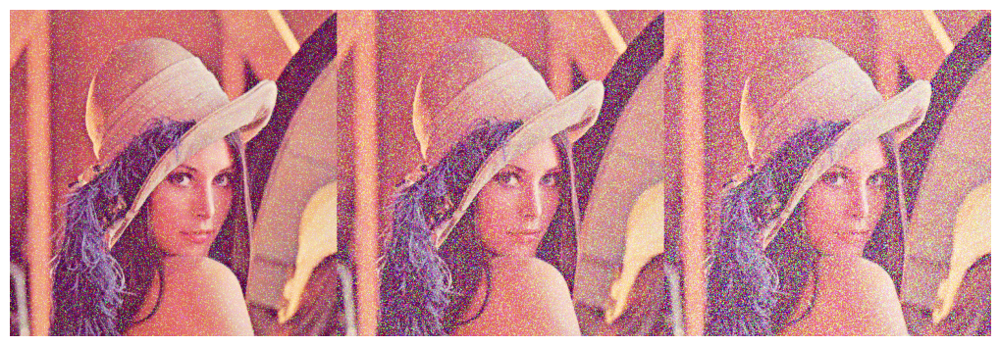

In [8]:
h, w, c = lena.shape
new_image = np.zeros((h, 3 * w, c), dtype=np.uint8)
new_image[:, :w] = salt_pepper(lena, 0.05, 0.05)
new_image[:, w: 2 * w] = salt_pepper(lena, 0.1, 0.1)
new_image[:, 2 * w:] = salt_pepper(lena, 0.15, 0.15)

show(new_image, size=10)

In [9]:
class Model(nn.Module):
    def __init__(self, is_gray: bool):
        super().__init__()
        n_channels = 1 if is_gray else 3
        self._is_gray = is_gray
        self._conv1 = nn.Conv2d(n_channels, n_channels, 3, stride=1, padding=1)
        self._conv2 = nn.Conv2d(n_channels, n_channels, 5, stride=1, padding=2)
        self._conv3 = nn.Conv2d(n_channels, n_channels, 7, stride=1, padding=3)

    def forward(self, image: torch.Tensor) -> torch.Tensor:
        image1 = self._conv1(image)
        image2 = self._conv2(image)
        image3 = self._conv3(image)
        res_image = (image1 + image2 + image3) / 3
        return res_image

    def transform_img(self, image: np.ndarray) -> torch.Tensor:
        # [1; h; w; 3?]
        image_batch = torch.tensor(image, dtype=torch.float).unsqueeze(0)
        image_batch /= 255
        if self._is_gray:
            image_batch = image_batch.unsqueeze(3)     # [1; h; w; 1]
        image_batch = image_batch.permute(0, 3, 1, 2)  # [1; 1/3; h; w]
        return image_batch
    
    def apply_filter(self, image: np.ndarray) -> np.ndarray:
        with torch.no_grad():
            image_batch = self.transform_img(image)
            pred = self(image_batch).permute(0, 2, 3, 1).squeeze()
            pred = torch.clip(pred * 255, 0, 255)
            new_image = pred.numpy().astype(np.uint8)
            return new_image

def get_best_filter(
    noise_image: np.ndarray,
    target_image: np.ndarray,
    is_gray: bool,
    n_epochs: int = 1000
) -> np.ndarray:
    model = Model(is_gray)
    image_batch = model.transform_img(noise_image)
    target = model.transform_img(target_image)

    optimizer = torch.optim.Adam(model.parameters(), lr=0.5)
    mse_loss = nn.MSELoss()

    pbar = tqdm(range(n_epochs), total=n_epochs)
    for _ in pbar:
        pred = model(image_batch)
        loss = mse_loss(pred.reshape(1, -1), target.reshape(1, -1))

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        pbar.set_postfix({"loss": loss.item()})
    
    return model

**4. (5 баллов)** Удалите диагональные полоски с изображения $lena\_diagonal.jpg$. Вычислите среднеквадратичную ошибку (mean squared error, $MSE$) для полученного результата и изображения $lena\_gray\_512.tif$. Задача будет засчитана при $MSE < 1500$. Тот, у кого по результатам проверки будет наименьшее значение MSE среди всех студентов для этой задачи, получит призовую шоколадку (раньше мы раздавали призовые баллы, но теперь у нас концепция фиксированного максимального количества баллов)

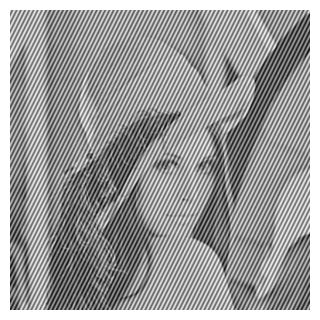

In [10]:
lena_diagonal = cv2.imread("lena_diagonal.jpg", cv2.IMREAD_GRAYSCALE)
gray_show(lena_diagonal)

In [11]:
model = get_best_filter(lena_diagonal, lena_gray, True)

  0%|          | 0/1000 [00:00<?, ?it/s]

MSE: 355.73109436035156


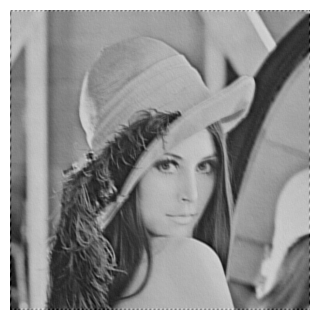

In [12]:
denoised_image = model.apply_filter(lena_diagonal)
mse = mean_squared_error(denoised_image, lena_gray)
print(f"MSE: {mse}")
gray_show(denoised_image)

**5. (5 баллов)** Подавите шум на изображении $lena\_color\_512\_noise.tif$. Вычислите среднеквадратичную ошибку ($MSE$) для полученного результата и изображения $lena\_color\_512.tif$. Задача будет засчитана при $MSE < 150$. Тот, у кого по результатам проверки будет наименьшее значение $MSE$ среди всех студентов для этой задачи, получит призовую шоколадку.

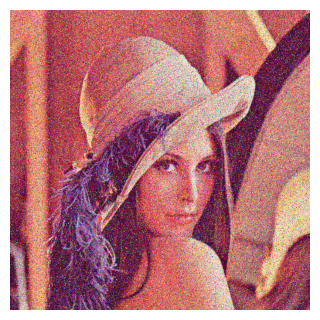

In [13]:
lena_noise = cv2.imread("lena_color_512-noise.tif")
show(lena_noise)

In [14]:
model = get_best_filter(lena_noise, lena, False)

  0%|          | 0/1000 [00:00<?, ?it/s]

MSE: 138.16981506347656


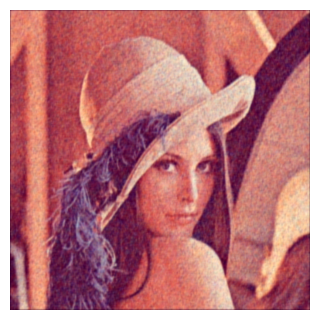

In [15]:
denoised_image = model.apply_filter(lena_noise)
mse = mean_squared_error(denoised_image, lena)
print(f"MSE: {mse}")
show(denoised_image)

**6. (5 баллов)** Выделите в изображении $table.jpg$ границы таблицы с использованием морфологических операций. Результатом обработки должно быть изображение, в котором удален весь текст и оставлены только границы таблицы

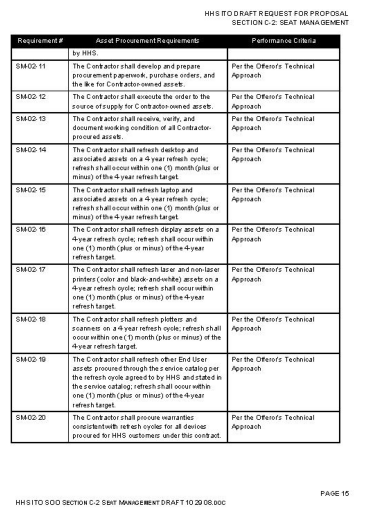

In [16]:
table = cv2.imread("table.jpg")
show(table, size=5)

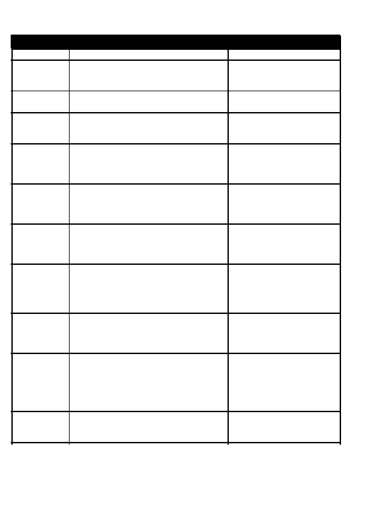

In [17]:
binary_table = cv2.cvtColor(table, cv2.COLOR_BGR2GRAY)
white_mask = binary_table < 200
binary_table[white_mask] = 0
binary_table[~white_mask] = 1

kernel = np.ones((2, 2), dtype='uint8') 
header = cv2.morphologyEx(binary_table, cv2.MORPH_OPEN, kernel)

kernel = np.ones((8, 1), dtype='uint8') 
vertical = cv2.morphologyEx(header, cv2.MORPH_CLOSE, kernel)

kernel = np.ones((1, 3), dtype='uint8') 
horizontal = cv2.morphologyEx(binary_table, cv2.MORPH_CLOSE, kernel, iterations=5)

result = ~np.logical_or(1 - horizontal, 1 - vertical)

gray_show(result, size=5)

**7. (5 баллов)** Отделите монеты от фона на изображении $coins\_1.jpg$, отсортируйте монеты по убыванию размера. Сгенерируйте результирующее изображение с цветной разметкой областей, соответствующих монетам на исходном изображении: на черном фоне должны быть выделены разными цветами области, соответствующие монетам. В центре каждой выделенной области разместите порядковый номер монеты в соответствии с сортировкой монет по размеру (в центре области, соответствующей самой большой монете, должно стоять число 1)

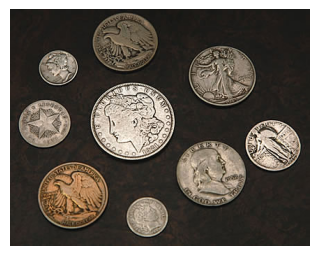

In [18]:
coins_1 = cv2.imread("coins_1.jpg")
show(coins_1)

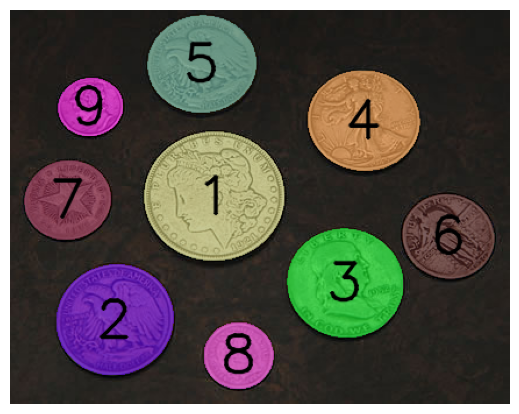

In [19]:
binary_coins = cv2.cvtColor(coins_1, cv2.COLOR_BGR2GRAY)
white_mask = binary_coins < 50
binary_coins[white_mask] = 0
binary_coins[~white_mask] = 1

contours, _ = cv2.findContours(binary_coins, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

ellipses = []
for countour in contours:
    if len(countour) > 70:
        ellipses.append(cv2.fitEllipse(countour))

ellipses = sorted(ellipses, reverse=True, key=lambda ell: ell[1][0] * ell[1][1])

result = coins_1.copy()
for i, ellipse in enumerate(ellipses):
    color = tuple(np.random.random(3) * 255)
    
    ellipse_img = np.zeros_like(result)
    cv2.ellipse(ellipse_img, ellipse, color, thickness=-1)
    
    mask = np.zeros(ellipse_img.shape[:-1], dtype=np.uint8)
    cv2.ellipse(mask, ellipse, 255, thickness=-1)
    mask = mask.astype(bool)
    
    result[mask] = (0.3 * result[mask] + 0.7 * ellipse_img[mask]).astype(np.uint8)


    center = (int(ellipse[0][0]) - 15, int(ellipse[0][1]) + 15)
    cv2.putText(result, f"{i + 1}", center, cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 0, 0), 2, cv2.LINE_AA)

show(result, size=5)

**8. (5 баллов)** Отделите монеты от текста на изображении $coins\_2.jpg.$ Сгенерируйте по входному изображению два изображения: на одном должны остаться только монеты, весь текст должен быть удален; на втором изображении должен остаться только текст, все монеты должны быть удалены.

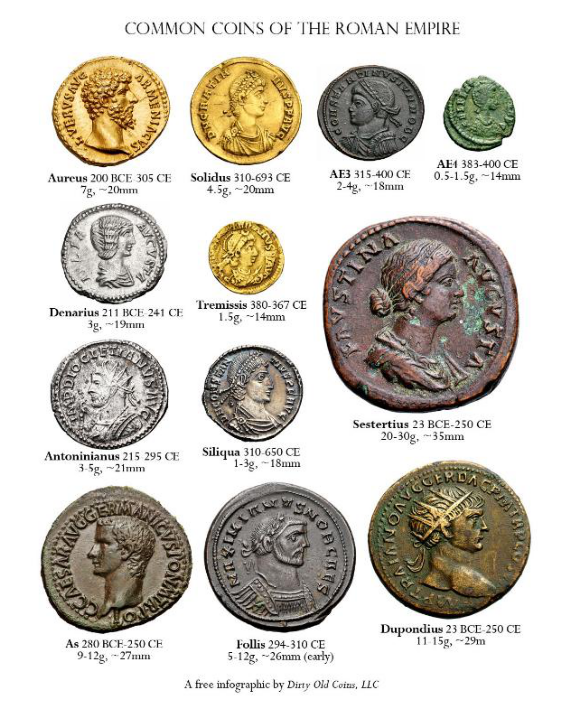

In [20]:
coins_2 = cv2.imread("coins_2.jpg")
show(coins_2, size=7)

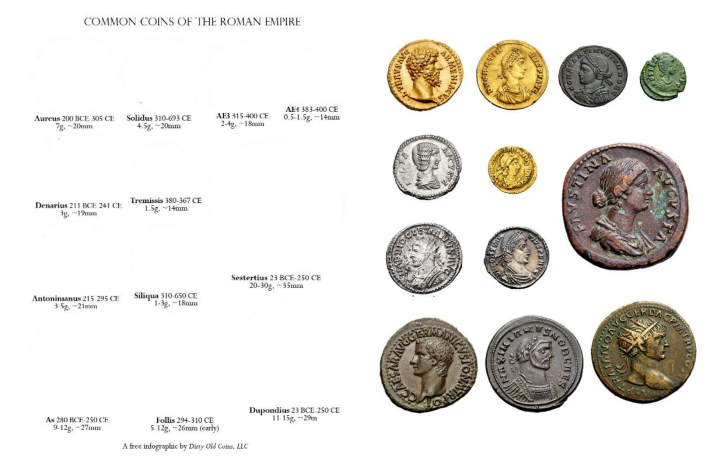

In [21]:
binary_coins = cv2.cvtColor(coins_2, cv2.COLOR_BGR2GRAY)
mask = binary_coins > 230
binary_coins[mask] = 0
binary_coins[~mask] = 1

kernel = np.ones((5, 5), dtype='uint8') 
opening = cv2.morphologyEx(binary_coins, cv2.MORPH_OPEN, kernel)
kernel = np.ones((20, 20), dtype='uint8')
closing =  cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel)
kernel = np.ones((9, 11), dtype='uint8')
dilation = cv2.dilate(closing, kernel, 0)

h, w, _ = coins_2.shape
result = np.full((h, w * 2, 3), (255, 255, 255), dtype=np.uint8)
mask = dilation == 0
result[:, :w][mask] = coins_2[mask]
result[:, w:][~mask] = coins_2[~mask]

show(result, size=7)

### Сравнение глобальных признаков

Для задач 9 и 10 надо реализовать общую функцию, которая принимет на вход:

* список дескрипторов (**id**, и сам дескриптор)
* количество максимально похожих для вывода **n**
* функцию сравнения дескрипторов

и отдает **n** пар **id** максимально похожих изображений.

In [22]:
class ImageDataset:
    def __init__(self, path: str, is_color: bool):
        self._path = path
        self._images = listdir(path)
        self._read_flag = cv2.IMREAD_COLOR if is_color else cv2.IMREAD_GRAYSCALE

    def __getitem__(self, item: int) -> np.ndarray:
        return cv2.imread(join(self._path, self._images[item]), self._read_flag)

    def __len__(self) -> int:
        return len(self._images)

In [23]:
def get_top_closest(descriptors: Any, comparator: Callable, top_n: int) -> Tuple[np.ndarray, np.ndarray]:
    scores, idx, jdx = [], [], []
    for i in range(len(descriptors)):
        for j in range(i + 1, len(descriptors)):
            score = comparator(descriptors[i], descriptors[j])
            scores.append(score)
            idx.append(i)
            jdx.append(j)
    top_idx = np.argsort(scores)[:top_n]
    return np.array(idx)[top_idx], np.array(jdx)[top_idx]

**9. (9 баллов)** Посмотрите на изображения в папке *Coral*. Посчитайте гистограммы изображений.  В этом задании надо попробовать:
* различные цветовые пространства (RGB, HSV, CIELab)
* различные способы разбиения на бины (разное количество для каждой характеристики)
* различные метрики сравнения $L_2$, $\chi^2$, пересечение гистограм

В итоге нужно сделать мини отчет по тому, какой метод работает лучше. И в конце выведите на экран 20 пар изображений с максимально похожими гистограммами, которые получаются этим методом.

In [24]:
def build_histogram(img: np.ndarray, cvt_color: int, n_bins: int = 256) -> List[np.ndarray]:
    img = cv2.cvtColor(img, cvt_color)
    n_channels = img.shape[2]
    hists = [cv2.calcHist([img], [i], None, [n_bins], [0, 256]) for i in range(n_channels)]
    hists = [cv2.normalize(hist, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX) for hist in hists]
    return hists

def histogram_comparator(distance_func: int, hist1: List[np.ndarray], hist2: List[np.ndarray]) -> float:
    assert len(hist1) == len(hist2)
    scores = [
        cv2.compare(hist1_ch, hist2_ch, distance_func) for hist1_ch, hist2_ch in zip(hist1, hist2)
    ]
    return -np.sum(scores)

def curry(function: Callable, arg: Any) -> Callable:
    def inner(*args, **kwargs) -> Any:
        update_wrapper(inner, function)
        return function(arg, *args, **kwargs)
    return inner

def plot_histogram_compare(
        img1: np.ndarray, hist1: List[np.ndarray], img2: np.ndarray, hist2: List[np.ndarray], size: int = 5
):
    fig, ax = plt.subplots(1, 3, figsize=(size * 3, size))

    ax[0].set_axis_off()
    ax[0].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
    ax[1].set_axis_off()
    ax[1].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))

    colors = ('b', 'g', 'r') if len(hist1) == 3 else ('b',)
    for hist1_ch, hist2_ch, color in zip(hist1, hist2, colors):
        ax[2].plot(hist1_ch, color=color)
        ax[2].plot(hist2_ch, color=color, linestyle='dashed')
    plt.show()

def run_experiment(cvt_color: int, distance: int, dataset: ImageDataset, top_n: int):
    comparator = curry(histogram_comparator, distance)
    histograms = [build_histogram(dataset[i], cvt_color) for i in range(len(dataset))]
    top = get_top_closest(histograms, comparator, top_n)
    for best_i, best_j in zip(*top):
        plot_histogram_compare(corel[best_i], histograms[best_i], corel[best_j], histograms[best_j])

In [25]:
corel = ImageDataset("./datasets/Corel", is_color=True)
print(len(corel))

111


Closest images by comparing histograms in RGB color space using Chi squared distance metric


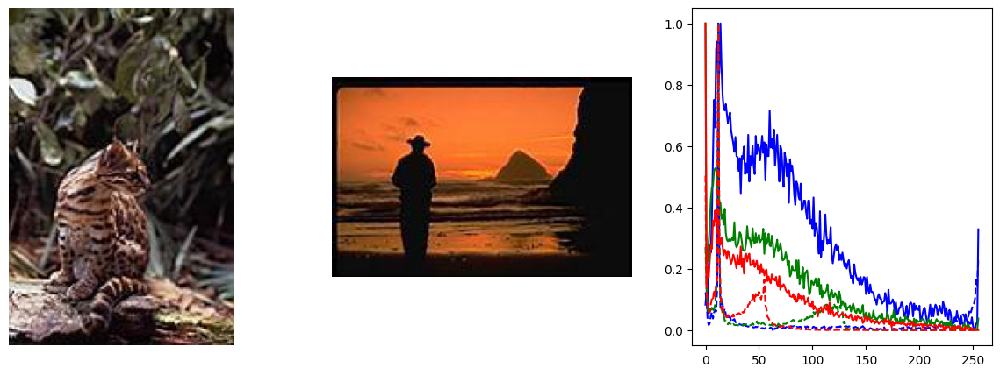

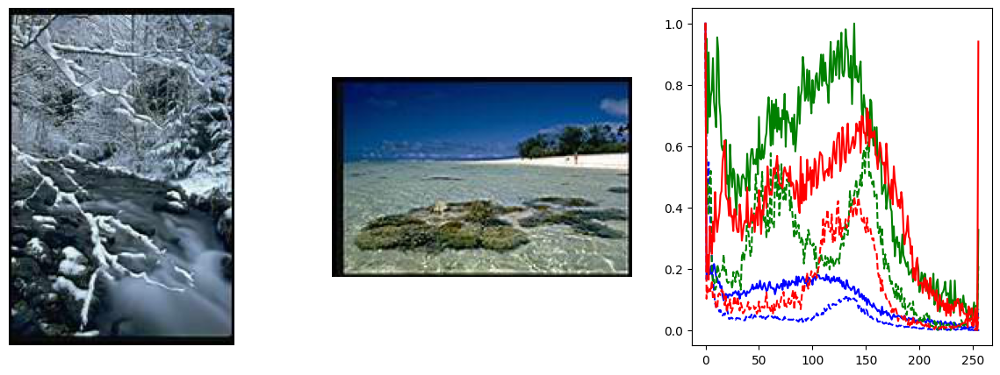

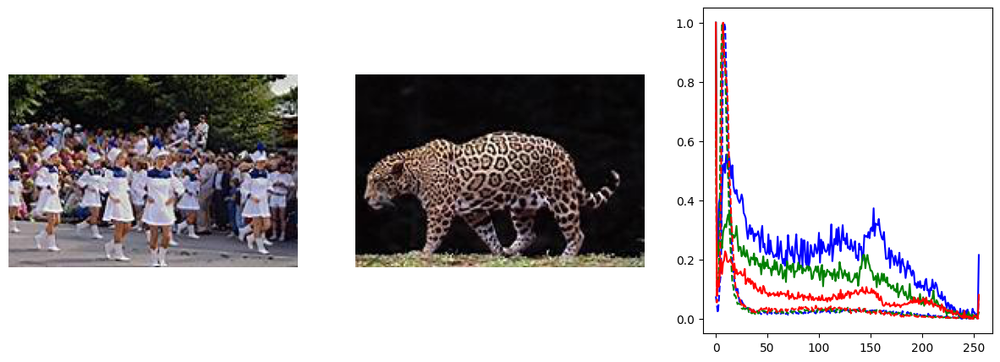

Closest images by comparing histograms in RGB color space using Intersection distance metric


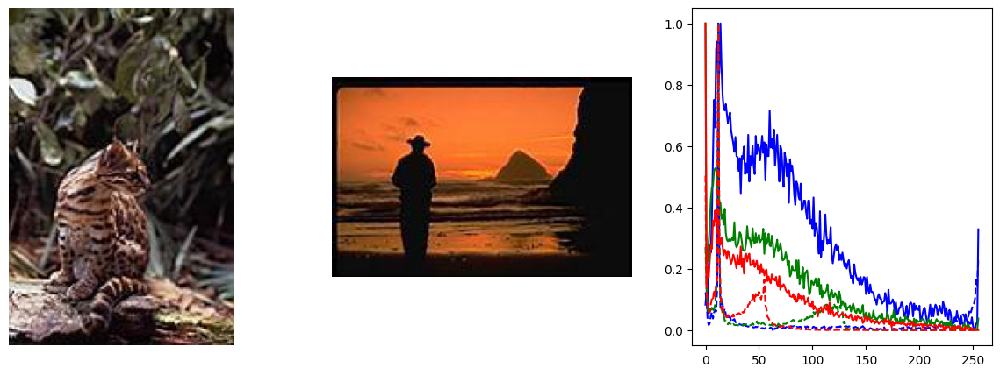

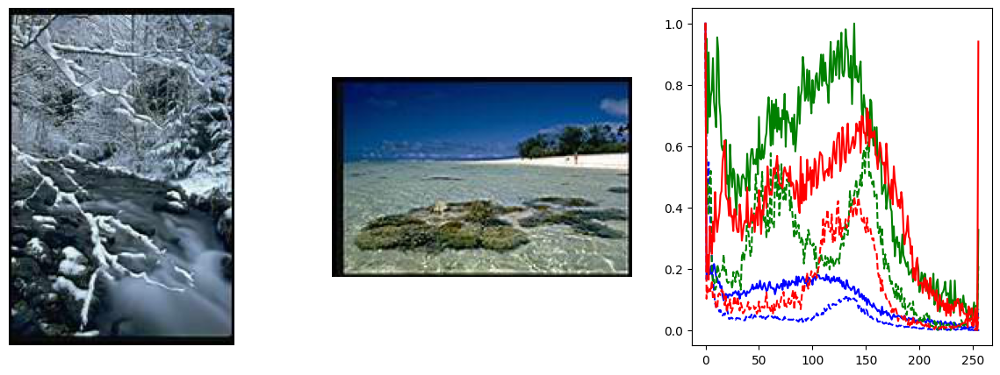

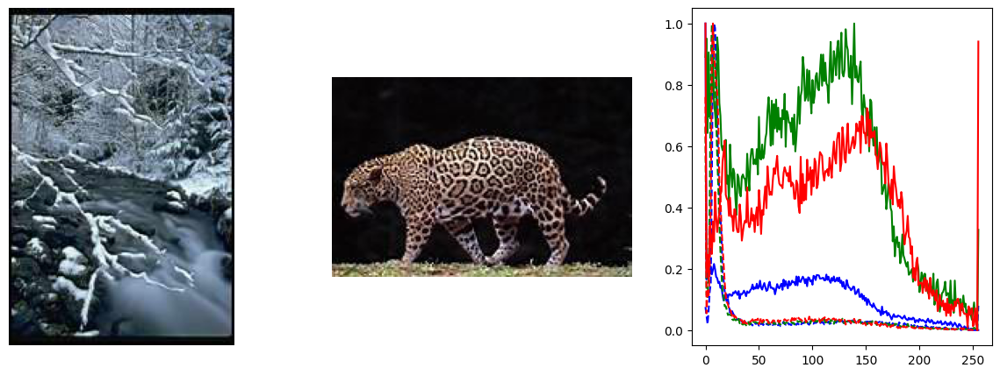

Closest images by comparing histograms in RGB color space using Correl distance metric


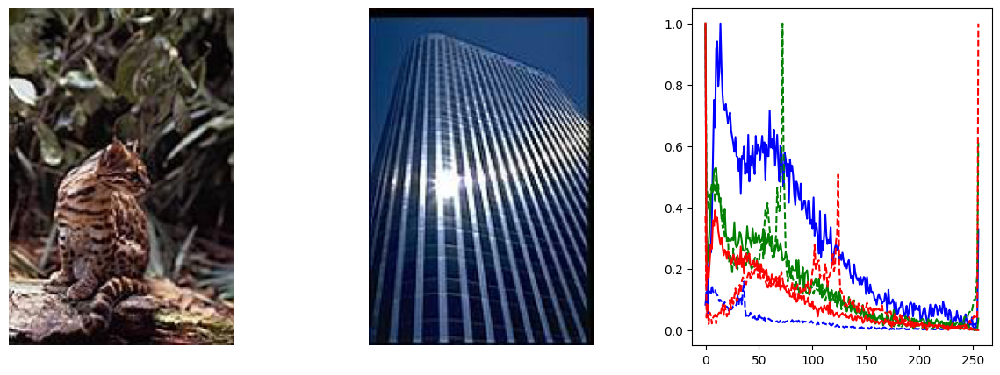

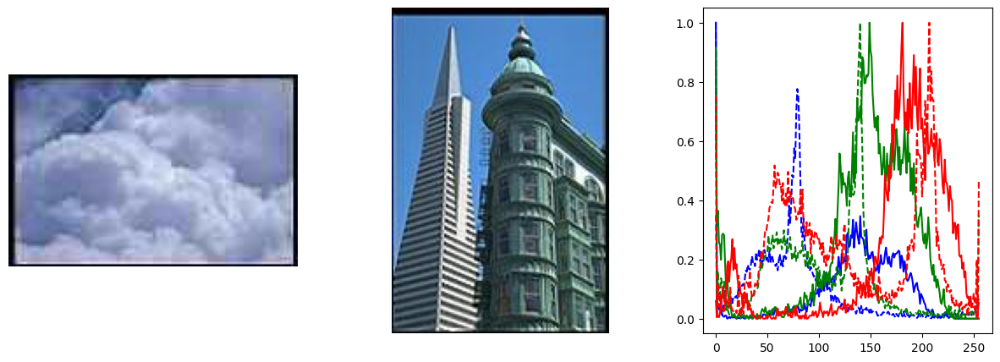

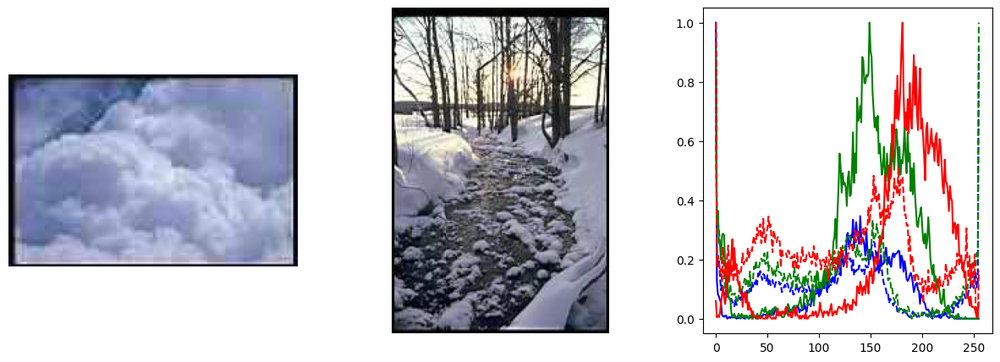

Closest images by comparing histograms in HSV color space using Chi squared distance metric


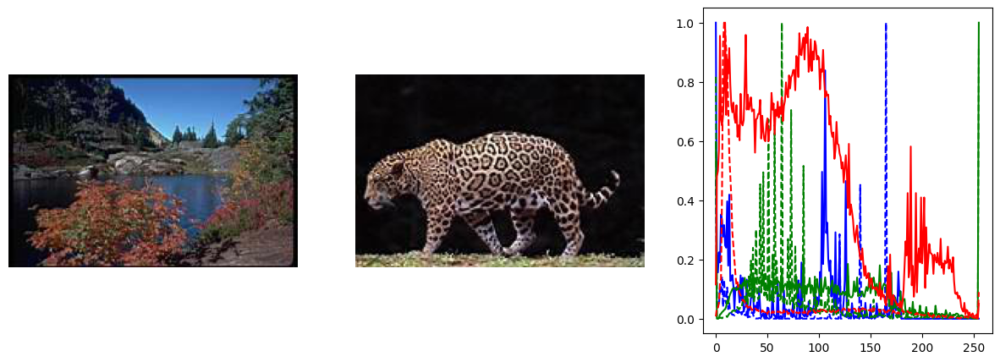

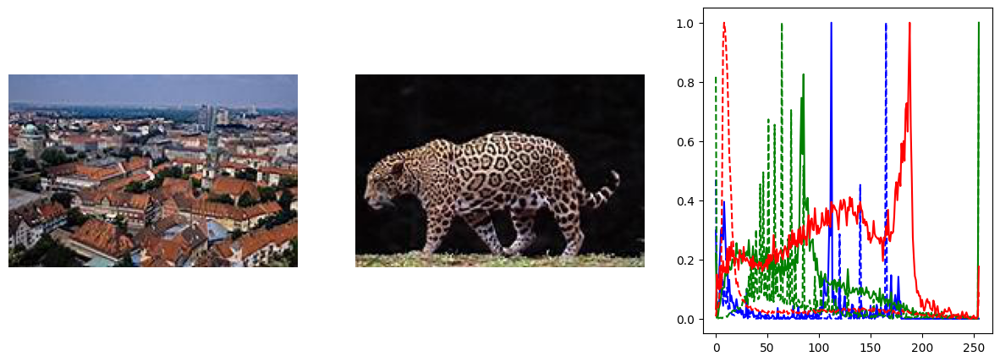

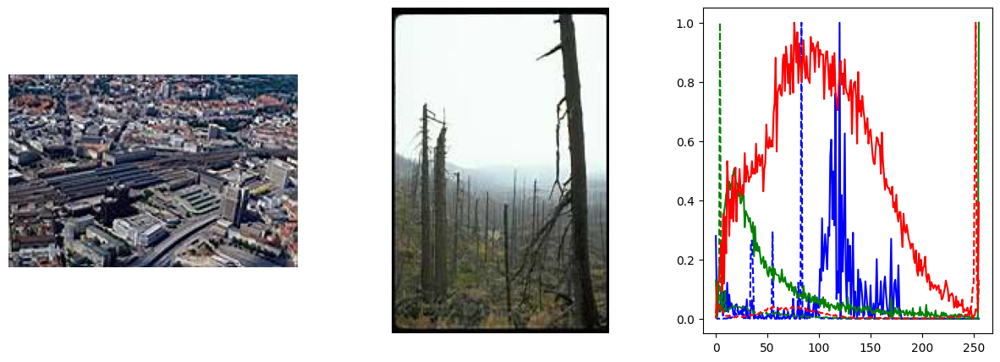

Closest images by comparing histograms in HSV color space using Intersection distance metric


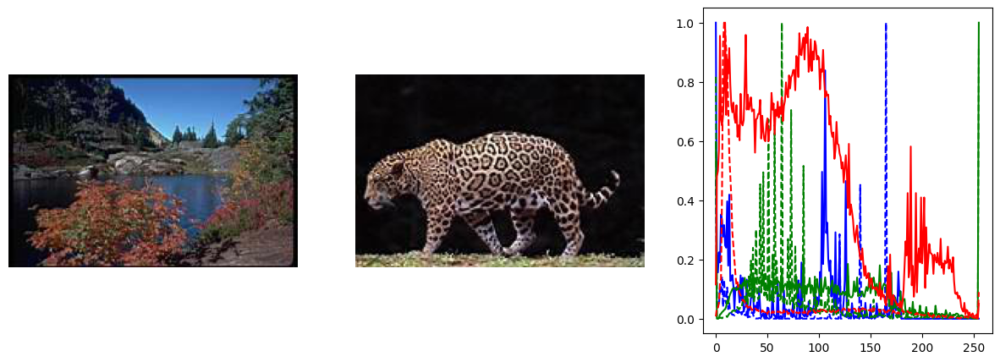

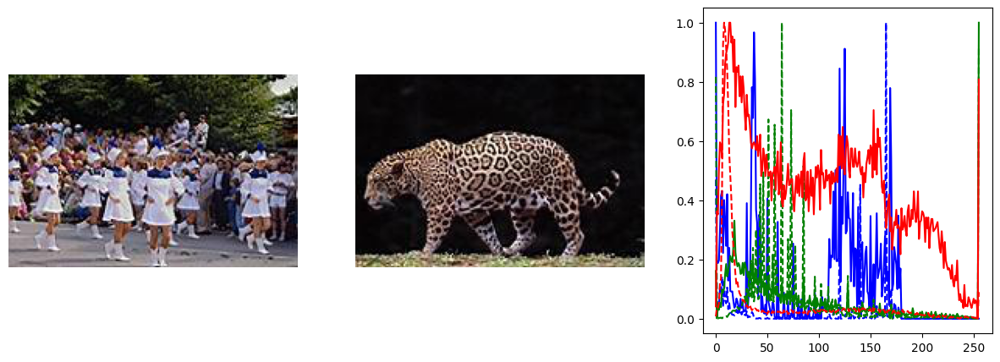

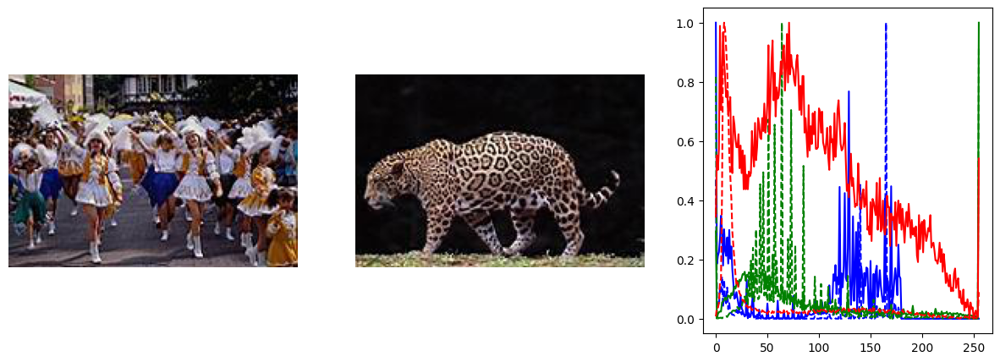

Closest images by comparing histograms in HSV color space using Correl distance metric


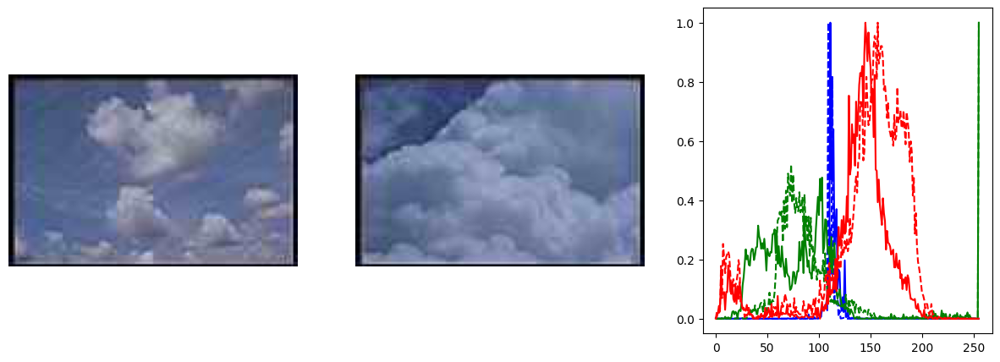

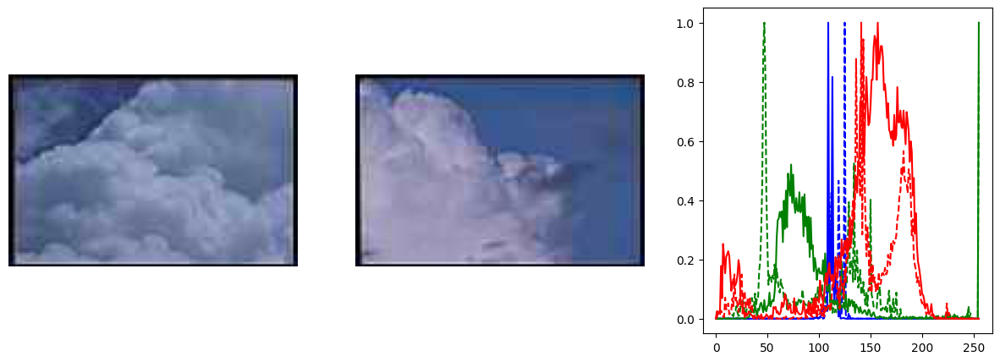

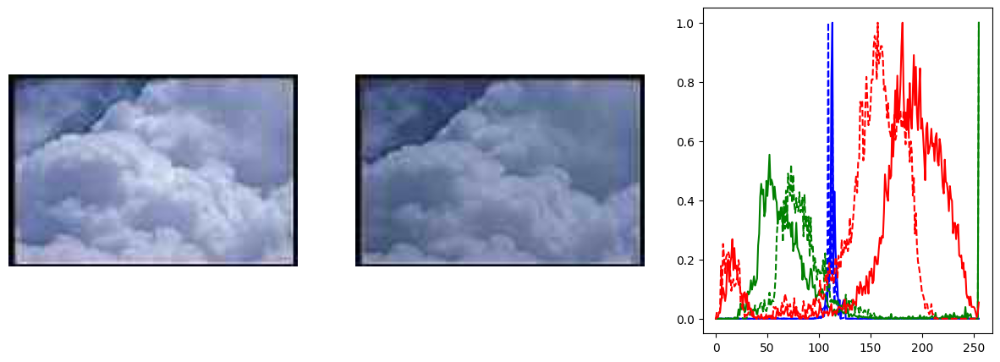

Closest images by comparing histograms in CieLAB color space using Chi squared distance metric


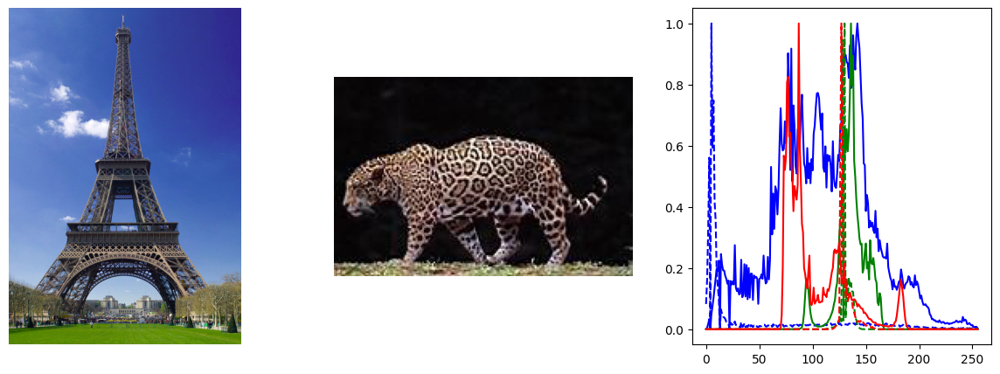

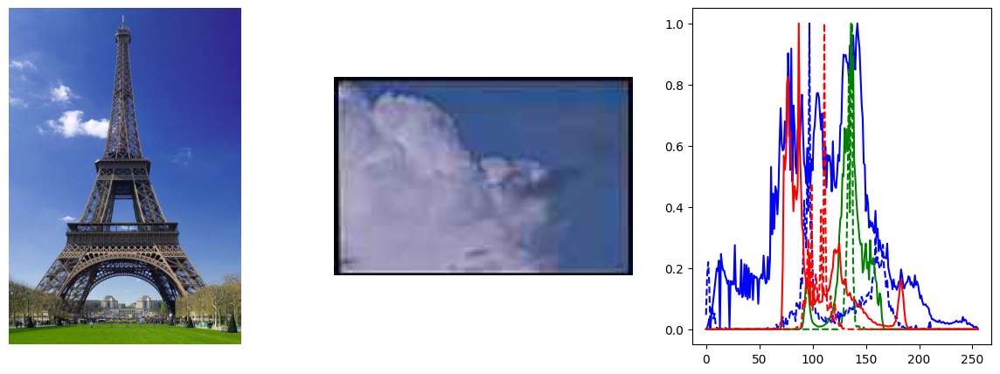

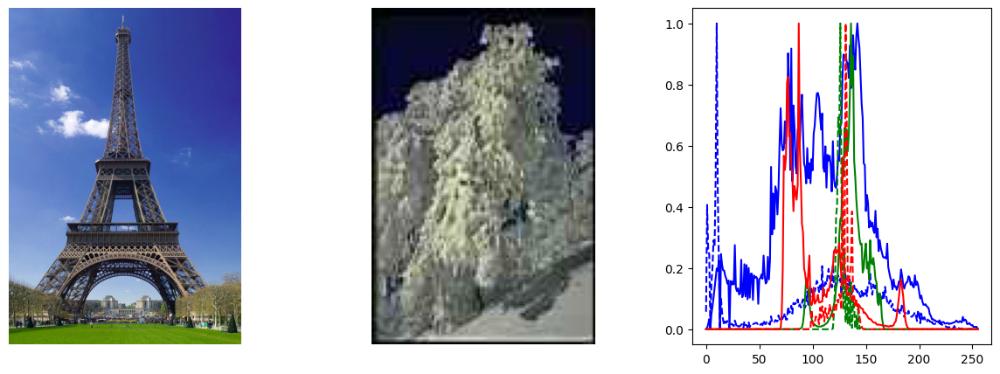

Closest images by comparing histograms in CieLAB color space using Intersection distance metric


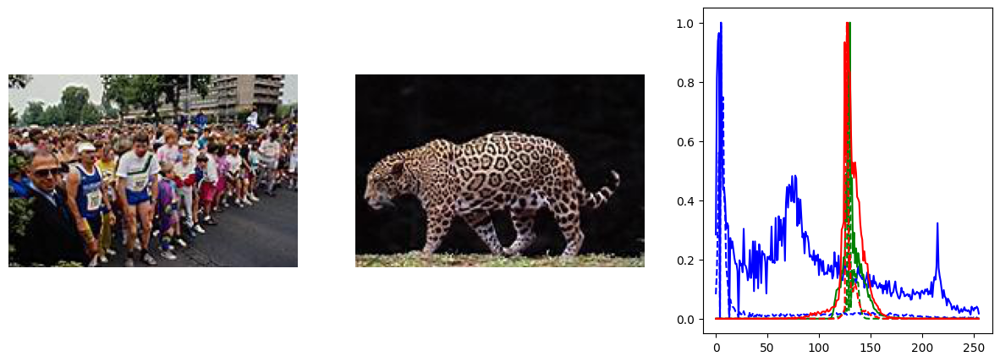

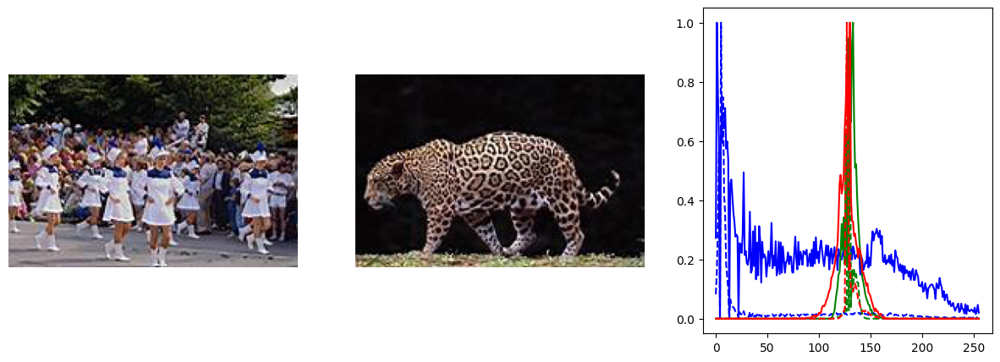

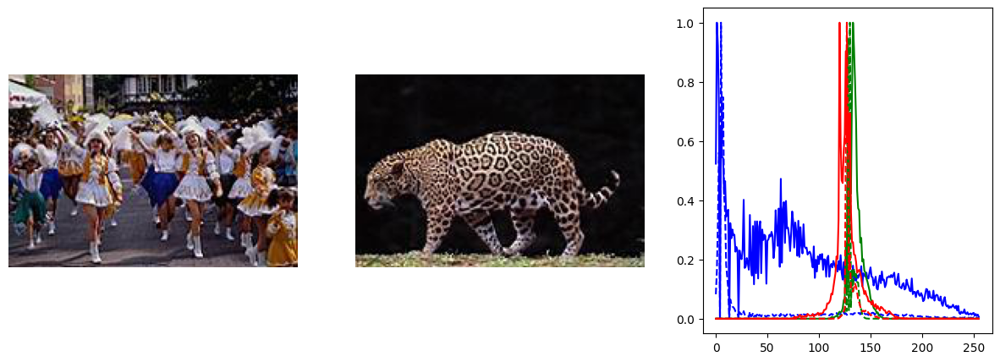

Closest images by comparing histograms in CieLAB color space using Correl distance metric


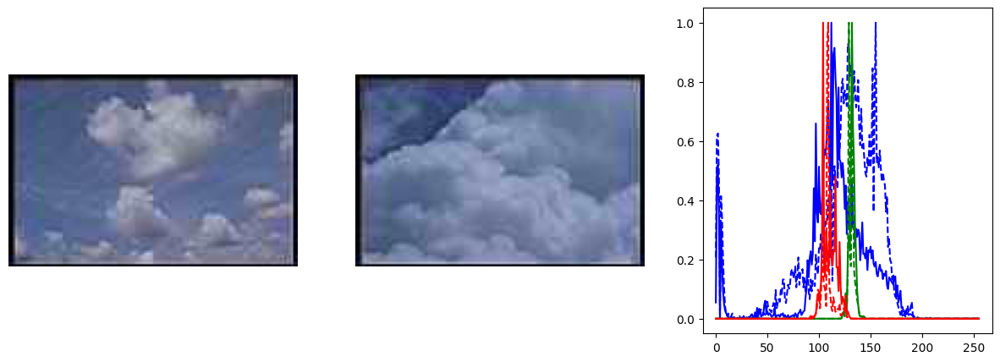

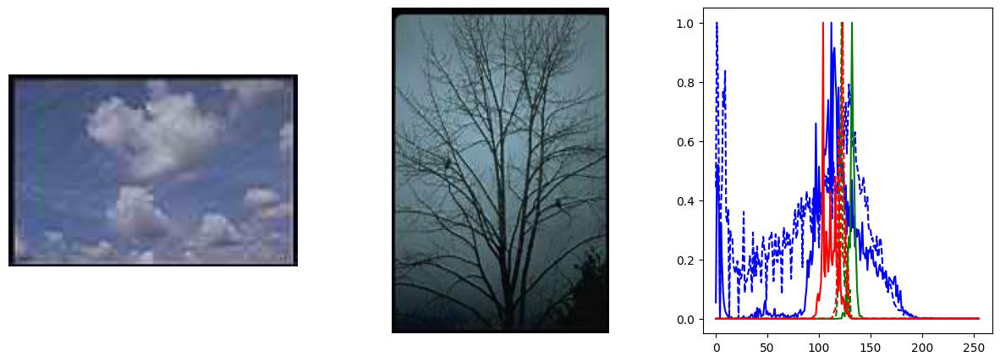

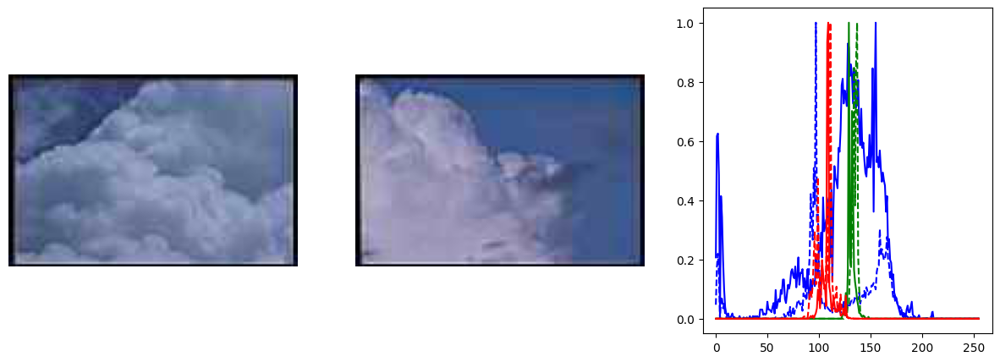

In [26]:
cvt_colors = {
    "RGB": cv2.COLOR_BGR2RGB,
    "HSV": cv2.COLOR_BGR2HSV,
    "CieLAB": cv2.COLOR_BGR2LAB,
}
hist_compare_distances = {
    "Chi squared": cv2.HISTCMP_CHISQR,
    "Intersection": cv2.HISTCMP_INTERSECT,
    "Correl" :cv2.HISTCMP_CORREL
}

for cvt_color_name, cvt_color in cvt_colors.items():
    for hist_compare_dist_name, hist_compare_distance in hist_compare_distances.items():
        print(f"Closest images by comparing histograms in {cvt_color_name} color space "
              f"using {hist_compare_dist_name} distance metric")
        run_experiment(cvt_color, hist_compare_distance, corel, 3)

# По субъективной визуальной оценке, кажется, что комбинация HSV + Correl позволили найти самые близкие картинки.

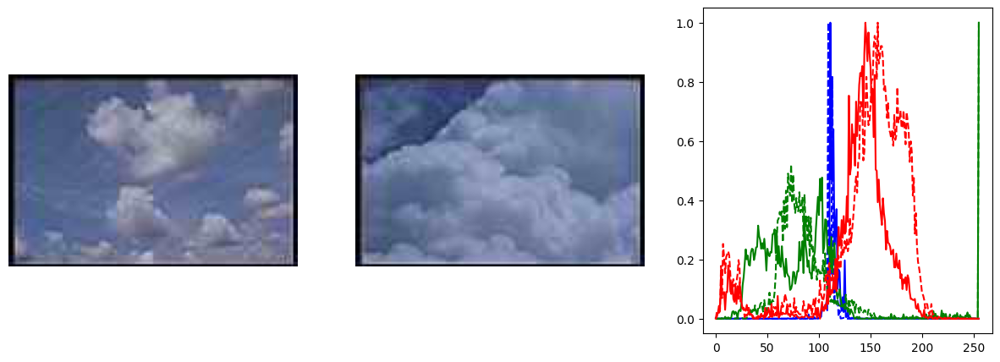

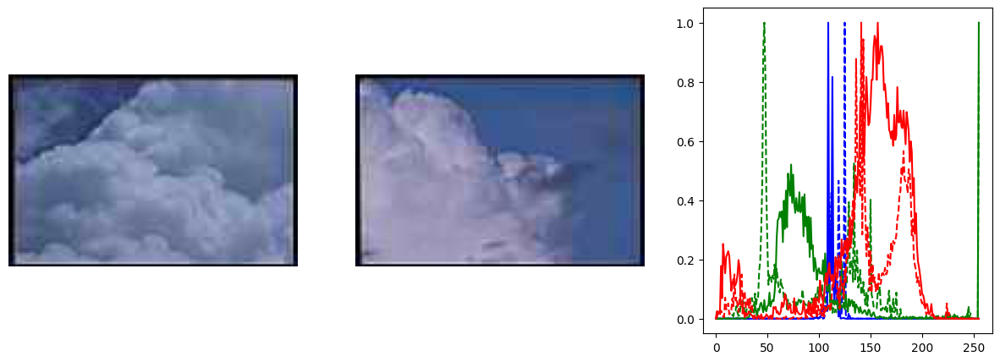

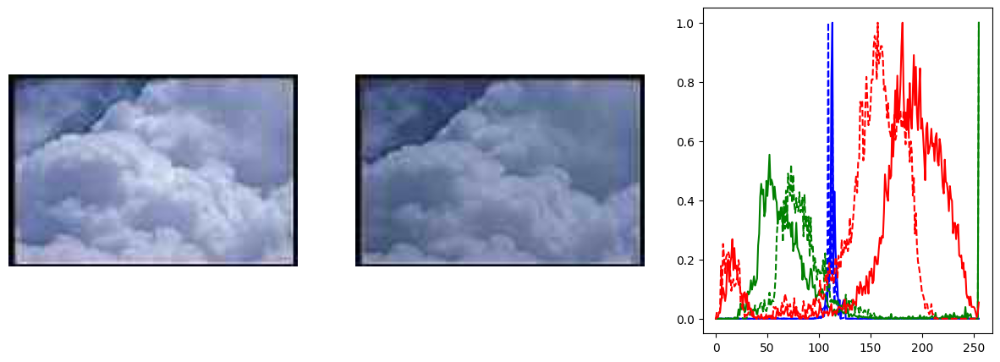

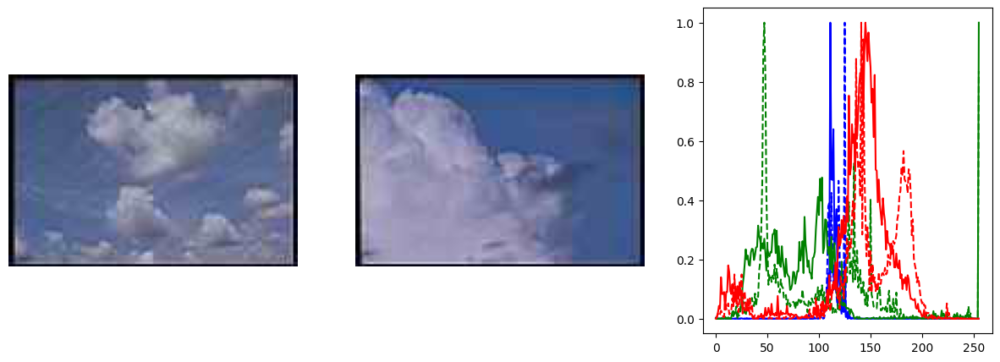

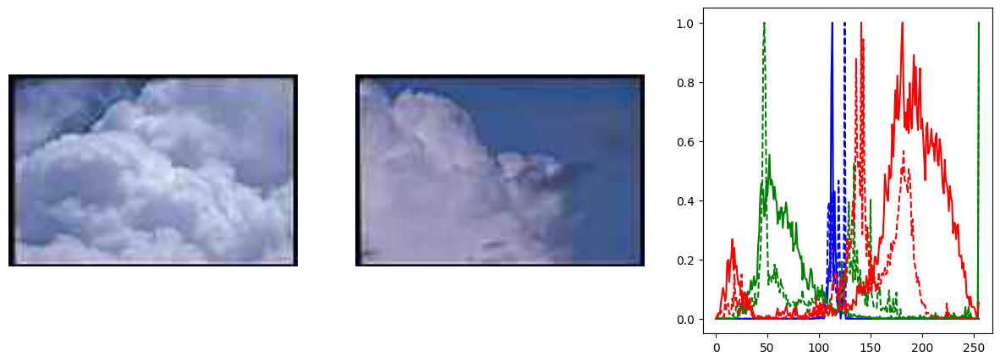

...

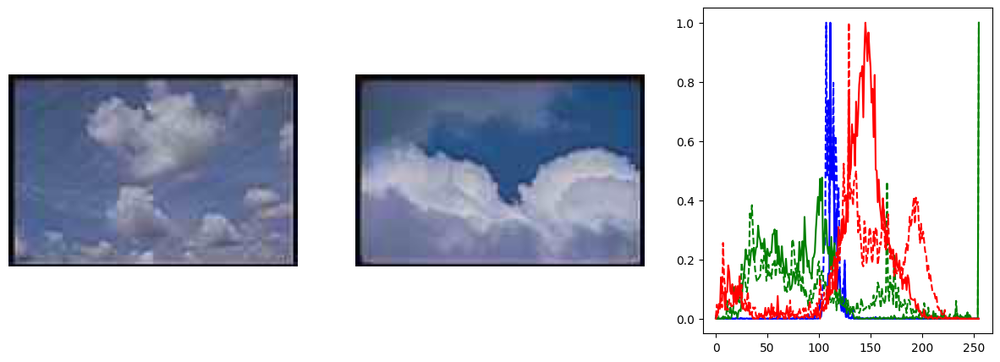

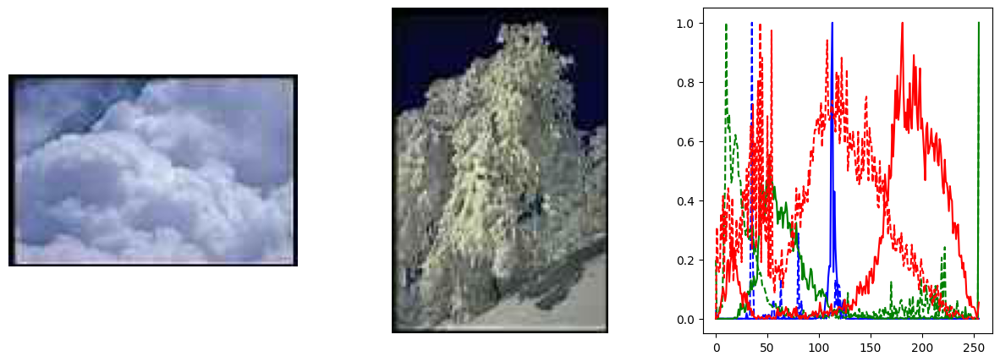

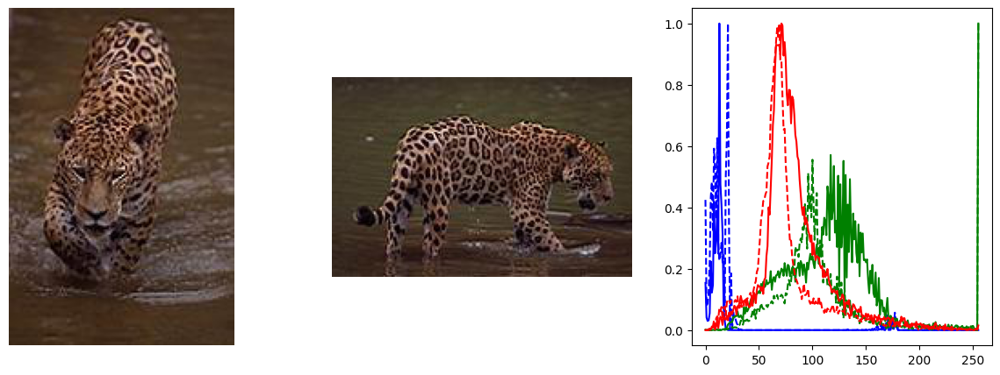

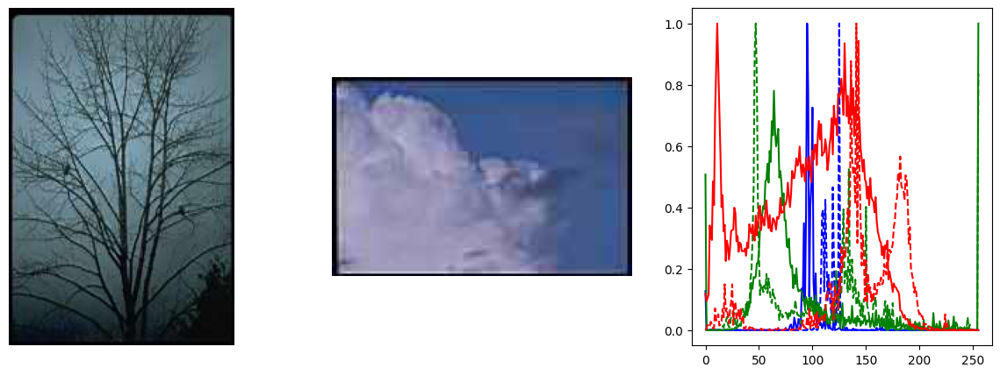

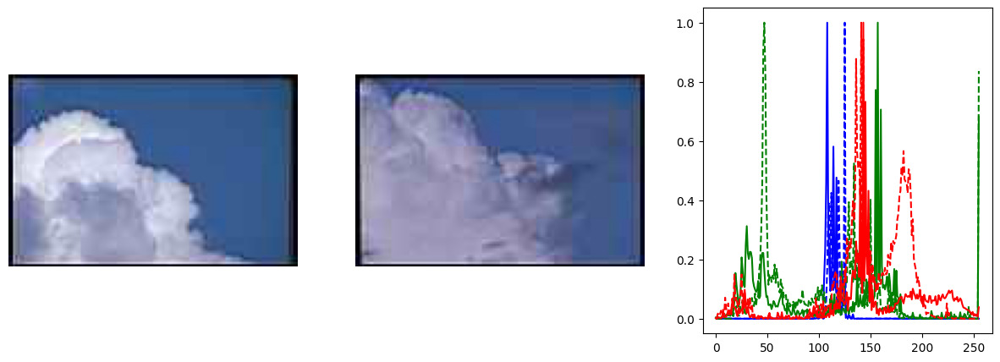

In [27]:
run_experiment(cv2.COLOR_BGR2HSV, cv2.HISTCMP_CORREL, corel, 20)

**10. (10 баллов)** Посмотрите на изображения в папке *leaves*. Посчитайте дескрипторы Фурье для каждого листочка изображений. Выведите на экран 20 пар изображений с максимально похожими дескрипторами.

In [28]:
leaves = ImageDataset("./datasets/leaves", is_color=False)
len(leaves)

69

In [29]:
def get_fourier_descriptor(img: np.ndarray, num=50) -> np.ndarray:
    coords = np.vstack(np.where(img == 0)).T
    center = np.mean(coords, axis=0).astype(int)
    coords -= center
    distances = np.linalg.norm(coords, axis=1)
    angles = np.arccos(coords[:, 1] / distances)
    angles[coords[:, 0] < 0] = 2 * np.pi - angles[coords[:, 0] < 0]
    points = np.argsort(angles)[np.linspace(0, angles.shape[0], num=num, dtype=int, endpoint=False)]

    distances = distances[points]
    n = distances.shape[0]
    coefs = np.array([
        distances.dot(np.exp(-complex(0, 1) * 2 * np.pi * k * np.arange(n) / n)) / n
        for k in range(n)]
    )
    coefs = np.abs(coefs)
    return (coefs / coefs[0])[1:]


def compare_fourier_descriptors(desc1: np.ndarray, desc2: np.ndarray) -> float:
    return mean_squared_error(desc1, desc2)

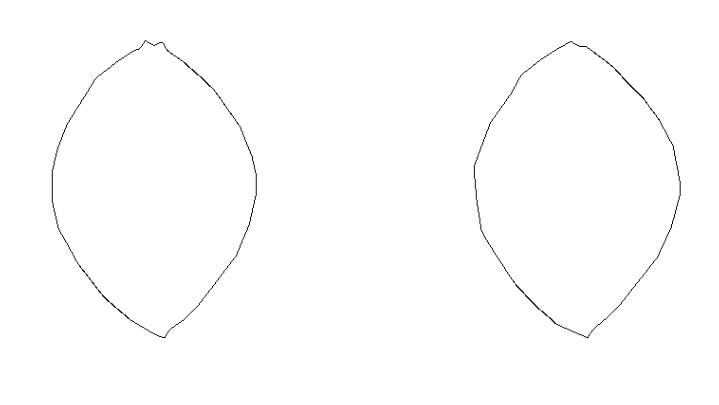

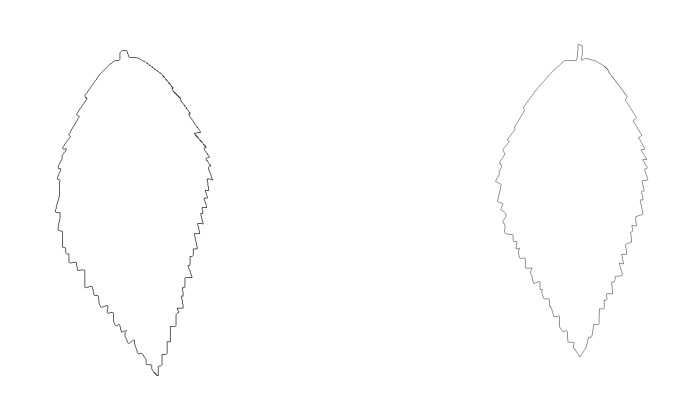

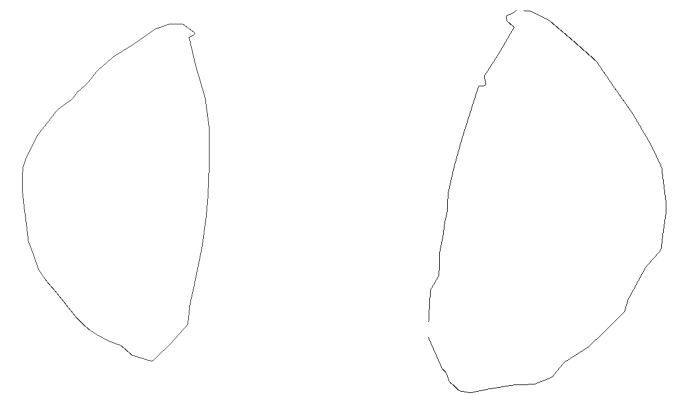

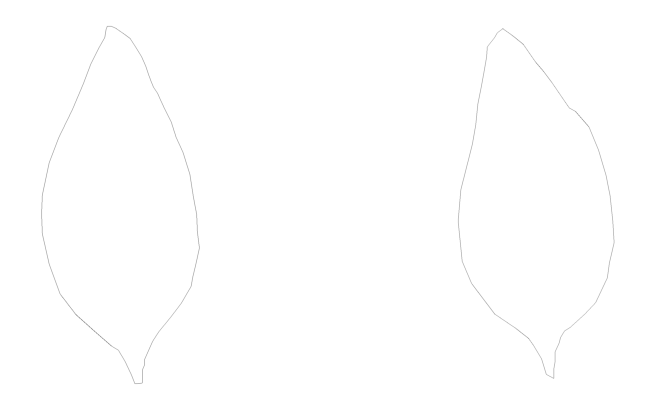

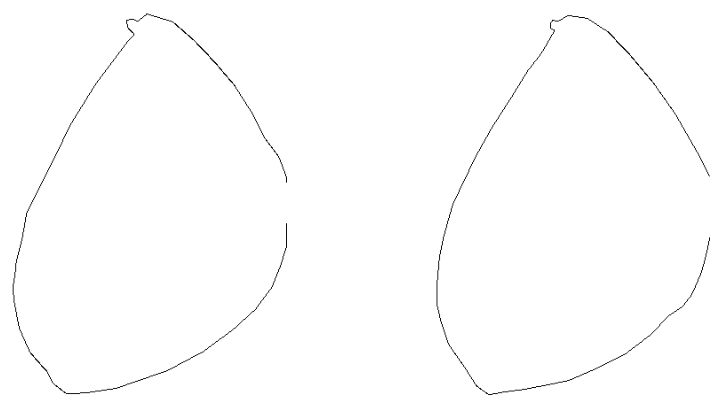

...

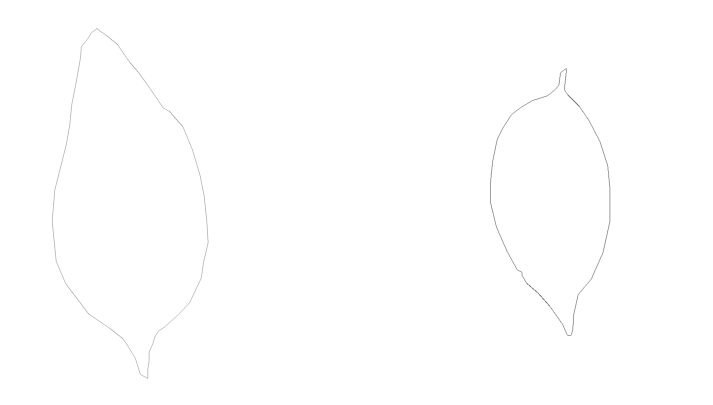

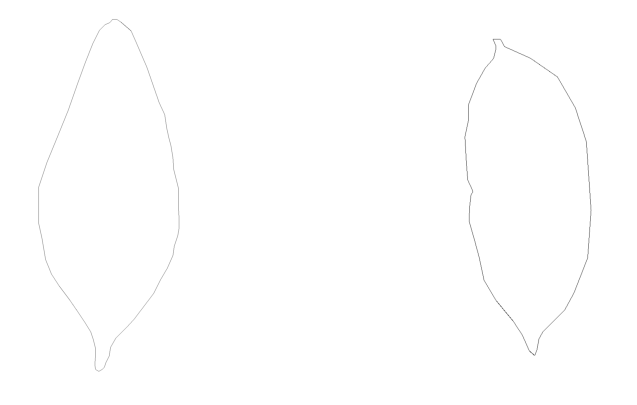

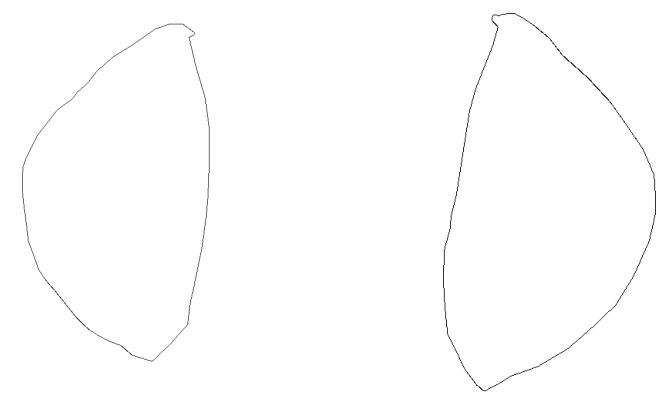

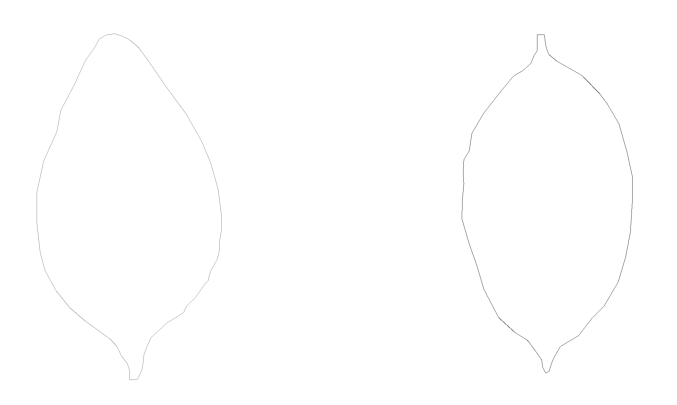

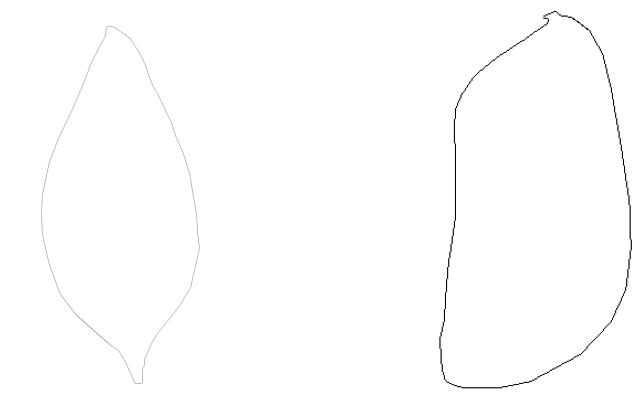

In [30]:
descriptors = [get_fourier_descriptor(img) for img in leaves]
top = get_top_closest(descriptors, compare_fourier_descriptors, 20)
for best_i, best_j in zip(*top):
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))

    ax[0].set_axis_off()
    ax[0].imshow(leaves[best_i], cmap="gray")
    ax[1].set_axis_off()
    ax[1].imshow(leaves[best_j], cmap="gray")
    
    plt.show()